In [2]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="5"

import numpy as np
import matplotlib.pyplot as plt
import pickle
from ce_utils import load_data, one_hot, test_batch_idxs, batch_flatten
from ce_utils import model_prob
from ce_model import binary_model, ensemble_model

In [3]:
root = '/mnt/disk2/data/private_data/SMhospital/capsule/1 preprocessed/sm_core/binary/5-fold/NP/'
model_dir = '/mnt/disk1/project/SMhospital/capsule/algorithm/ensemble/p3_2(core)/v2.00(5-fold)/model'

# Data

In [4]:
i = 2

pickle_in = open(root + "data_x_{}-fold.pickle".format(i),"rb")
test_x = pickle.load(pickle_in)
pickle_in.close()

pickle_in = open(root + "data_y_{}-fold.pickle".format(i),"rb")
test_y = pickle.load(pickle_in)
pickle_in.close()

print(test_x.shape, test_y.shape)

(4775, 512, 512, 3) (4775, 2)


# Model Prediction

In [5]:
nh_2_path = model_dir + '/NH_core_{}_fold'.format(i)
nd_2_path = model_dir + '/ND_core_{}_fold'.format(i)
b_2_path = model_dir + '/binary_core_{}_fold'.format(i)

NH_model = binary_model(nh_2_path)
ND_model = binary_model(nd_2_path)
E_model = ensemble_model(nh_2_path, nd_2_path)
B_model = binary_model(b_2_path)

W1226 15:12:58.619498 139800628385536 deprecation_wrapper.py:119] From /mnt/disk1/project/SMhospital/capsule/algorithm/ensemble/ce_model.py:107: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.

W1226 15:13:00.044672 139800628385536 deprecation_wrapper.py:119] From /mnt/disk1/project/SMhospital/capsule/algorithm/ensemble/ce_model.py:108: The name tf.train.import_meta_graph is deprecated. Please use tf.compat.v1.train.import_meta_graph instead.

W1226 15:13:02.782096 139800628385536 deprecation.py:323] From /usr/local/lib/python3.5/dist-packages/tensorflow/python/training/saver.py:1276: checkpoint_exists (from tensorflow.python.training.checkpoint_management) is deprecated and will be removed in a future version.
Instructions for updating:
Use standard file APIs to check for files with this prefix.


In [6]:
nh_output, nd_output = model_prob(E_model, test_x, model_type = 'ensemble')
b_output = model_prob(B_model, test_x)

#: 4775 / Inference Time: 00:01:06
#: 4775 / Inference Time: 00:00:27


# Grad-CAM

In [9]:
featuremap_list = ['conv2d/Relu:0', 'conv2d_1/Relu:0', 'maxp1/MaxPool:0', 
                    'conv2d_2/Relu:0', 'conv2d_3/Relu:0', 'maxp2/MaxPool:0', 
                    'conv2d_4/Relu:0', 'conv2d_5/Relu:0', 'maxp3/MaxPool:0', 
                    'conv2d_6/Relu:0', 'conv2d_7/Relu:0', 'maxp4/MaxPool:0', 
                    'conv2d_8/Relu:0', 'conv2d_9/Relu:0', 'maxp5/MaxPool:0', 
                    'conv2d_10/Relu:0', 'conv2d_11/Relu:0', 'maxp6/MaxPool:0', 
                    'conv2d_12/Relu:0', 'conv2d_13/Relu:0', 'maxp7/MaxPool:0']

In [10]:
f_n = 'conv2d_11/Relu:0'

## H than D

### chosen sample before

In [8]:
# 2-fold
# selected by LHH : 2453, 3165, 2745
# e > b
# h 2940 4396 4513 2595 4642
# d 3448 4258 3735 3698 4004 3747 3565 4440 2629
# h, d 3448? 4771?
# e < b 4532 4226 2955 3791

H_than_D = [2940, 4396, 4513, 2595, 4642]

In [9]:
nh_cam = NH_model.get_gradcam(test_x[H_than_D], featuremap_name = f_n)
nd_cam = ND_model.get_gradcam(test_x[H_than_D], featuremap_name = f_n)
e_cam = E_model.get_gradcam(test_x[H_than_D], featuremap_name = f_n)
b_cam = B_model.get_gradcam(test_x[H_than_D], featuremap_name = f_n)

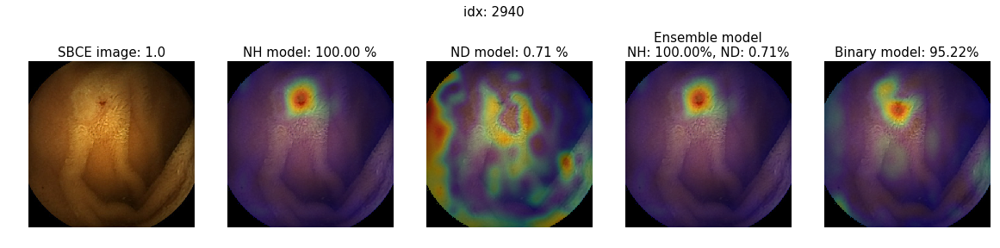

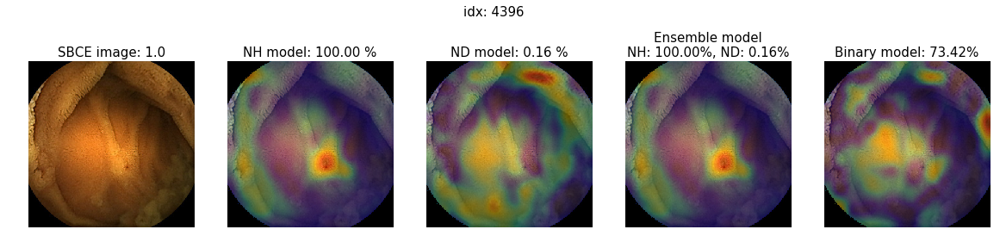

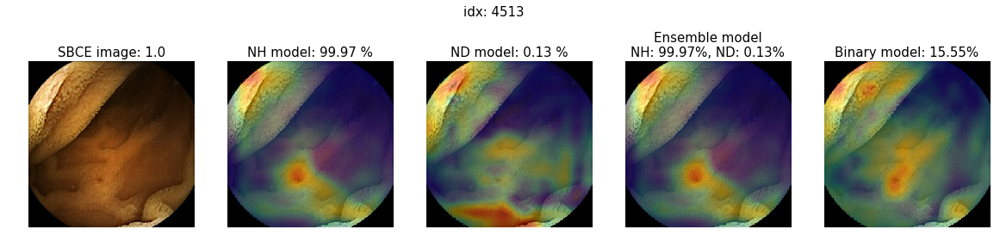

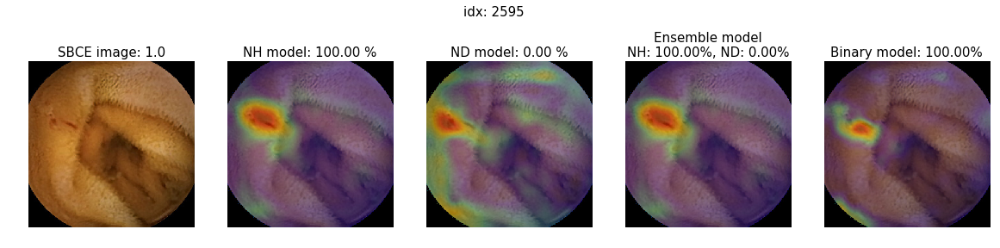

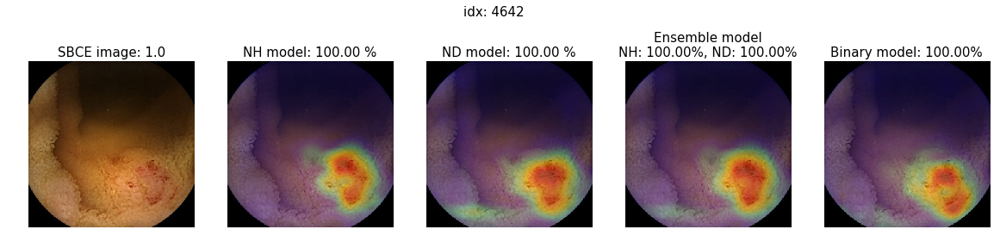

In [10]:
for i, n in zip(range(len(H_than_D)), H_than_D):
    plt.figure(figsize = (20, 5))
    plt.suptitle("idx: {}".format(n), y = 0.95, fontsize = 15)
    plt.subplot(151)
    plt.title("SBCE image: {}".format(test_y[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.axis('off')
    plt.subplot(152)
    plt.title("NH model: {:.2f} %".format(100*nh_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nh_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(153)
    plt.title("ND model: {:.2f} %".format(100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nd_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(154)
    plt.title("Ensemble model\nNH: {:.2f}%, ND: {:.2f}%".format(100*nh_output[n, 1], 100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(e_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(155)
    plt.title("Binary model: {:.2f}%".format(100*b_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(b_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.show()

### H prob > 0.5 and D prob < 0.5

In [26]:
H_than_D = []

for i in range((len(test_x))):
    if nh_output[i, 1] > 0.5 and nd_output[i, 1] < 0.5:
        H_than_D.append(i) 
        
H_than_D = np.asarray(H_than_D)

In [27]:
batch_idxs = test_batch_idxs(H_than_D)

In [28]:
nh_cams, nd_cams, e_cams, b_cams  = [], [], [], []

for b_idx in batch_idxs:
    nh_cam = NH_model.get_gradcam(test_x[H_than_D[b_idx]], featuremap_name = f_n)
    nd_cam = ND_model.get_gradcam(test_x[H_than_D[b_idx]], featuremap_name = f_n)
    e_cam = E_model.get_gradcam(test_x[H_than_D[b_idx]], featuremap_name = f_n)
    b_cam = B_model.get_gradcam(test_x[H_than_D[b_idx]], featuremap_name = f_n)
    
    nh_cams.append(nh_cam), nd_cams.append(nd_cam), e_cams.append(e_cam), b_cams.append(b_cam)

In [29]:
nh_cams, nd_cams, e_cams, b_cams = batch_flatten(nh_cams), batch_flatten(nd_cams), batch_flatten(e_cams), batch_flatten(b_cams)

In [33]:
batch_idxs = test_batch_idxs(H_than_D, batch_size = 10)
len(batch_idxs)

16

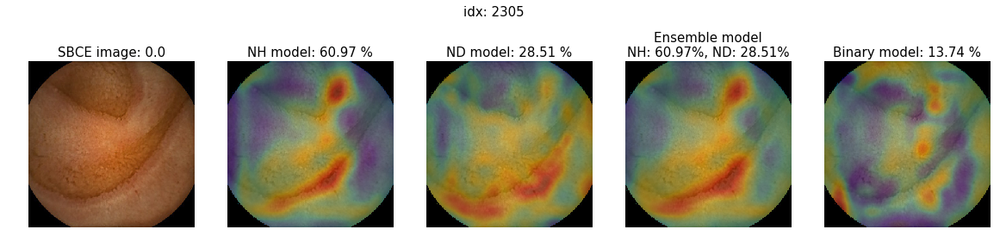

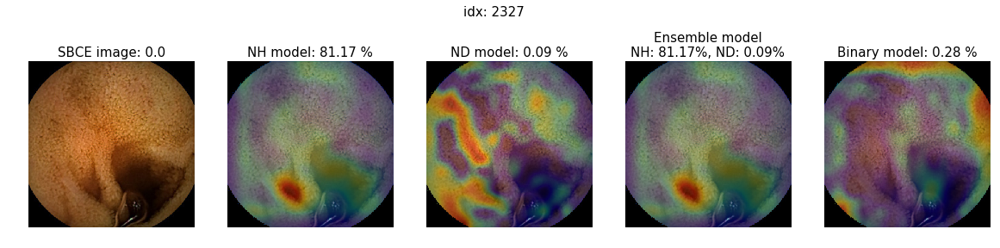

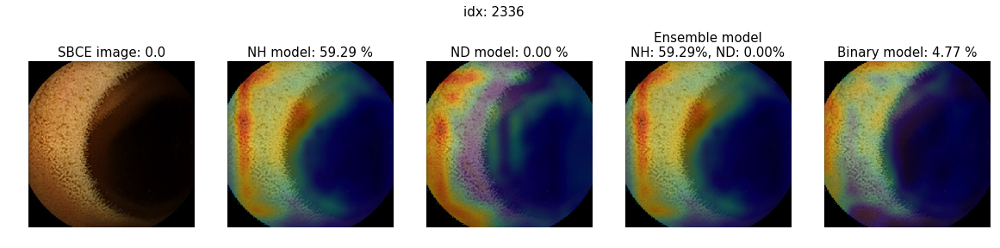

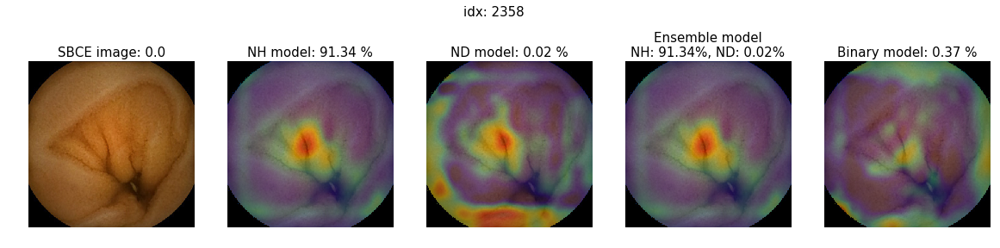

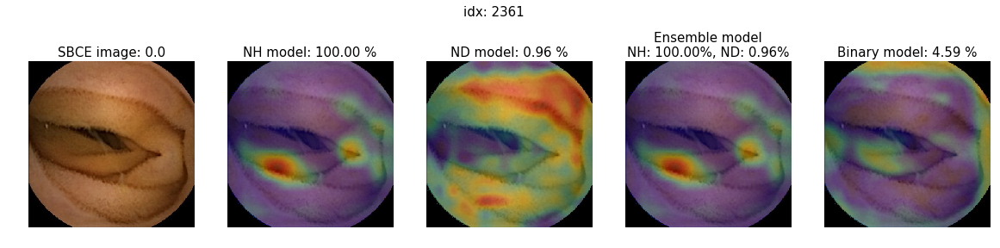

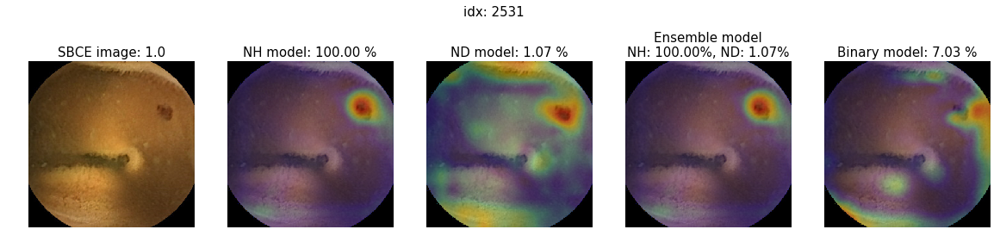

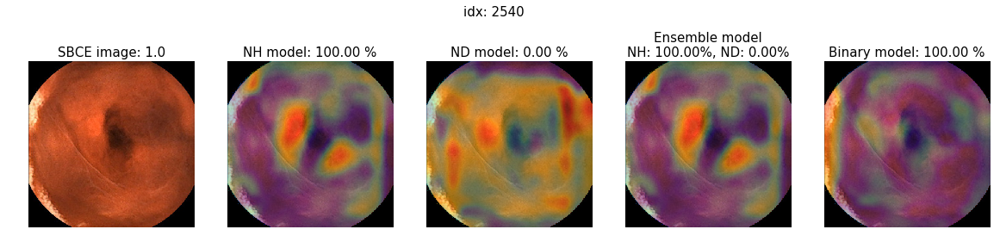

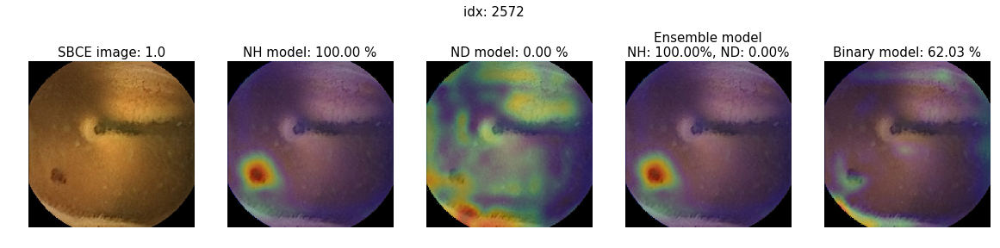

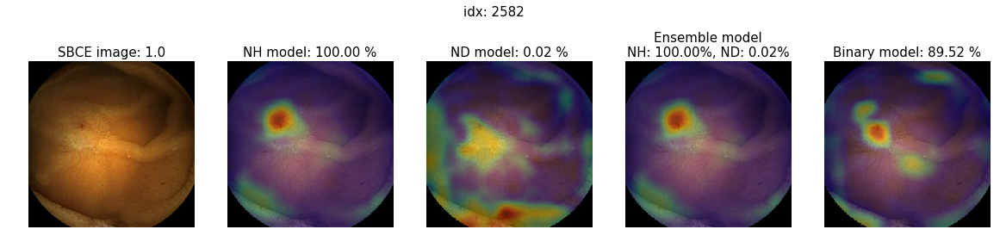

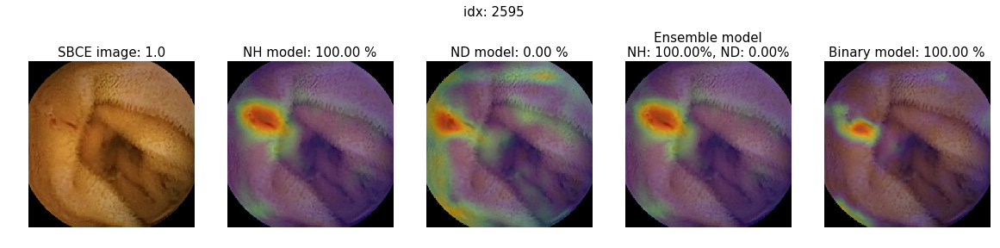

In [45]:
for i in batch_idxs[-10]:
    n = H_than_D[i]
    plt.figure(figsize = (20, 5))
    plt.suptitle("idx: {}".format(n), y = 0.95, fontsize = 15)
    plt.subplot(151)
    plt.title("SBCE image: {}".format(test_y[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.axis('off')
    plt.subplot(152)
    plt.title("NH model: {:.2f} %".format(100*nh_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nh_cams[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(153)
    plt.title("ND model: {:.2f} %".format(100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nd_cams[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(154)
    plt.title("Ensemble model\nNH: {:.2f}%, ND: {:.2f}%".format(100*nh_output[n, 1], 100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(e_cams[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(155)
    plt.title("Binary model: {:.2f} %".format(100*b_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(b_cams[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.show()

In [97]:
H_than_D = [3763, 4602, 4748, 4693, 4396, 4528, 4198, 4235, 4393, 4313, 4301, 3960, 3990, 
            3987, 3632, 3762, 3643, 3232, 3450, 3420, 3001, 2619, 2680, 2595]

In [98]:
nh_cam = NH_model.get_gradcam(test_x[H_than_D], featuremap_name = f_n)
nd_cam = ND_model.get_gradcam(test_x[H_than_D], featuremap_name = f_n)
e_cam = E_model.get_gradcam(test_x[H_than_D], featuremap_name = f_n)
b_cam = B_model.get_gradcam(test_x[H_than_D], featuremap_name = f_n)

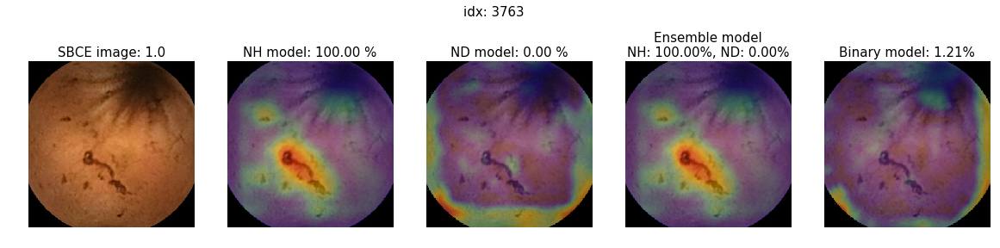

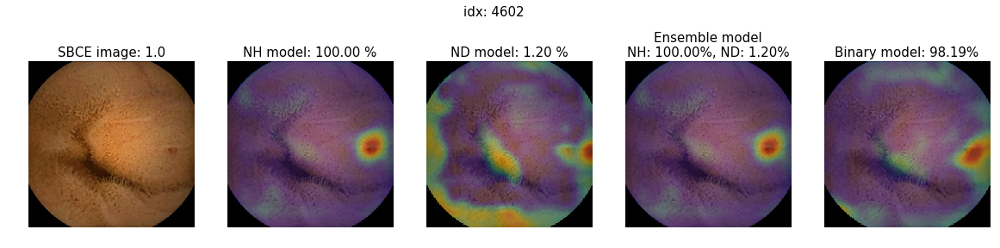

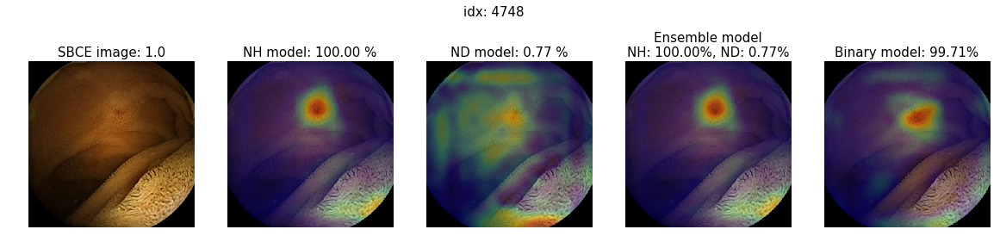

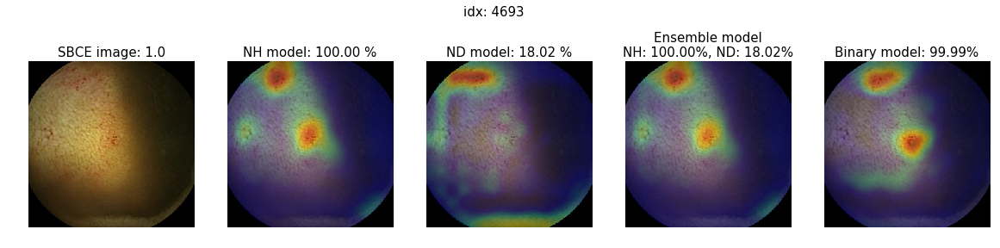

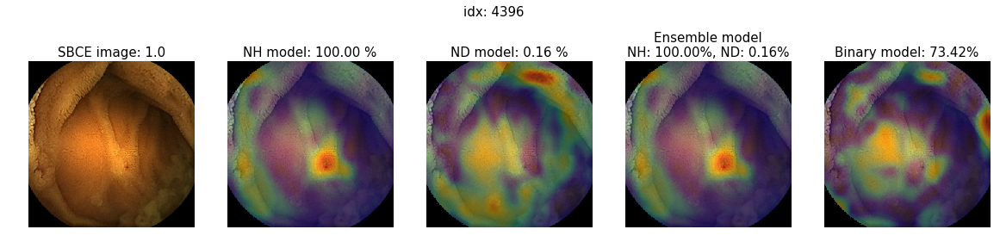

...

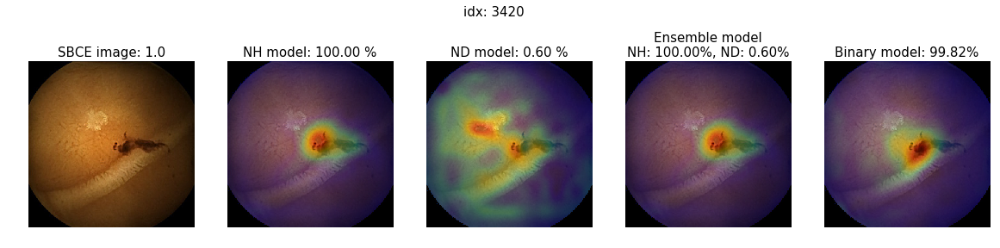

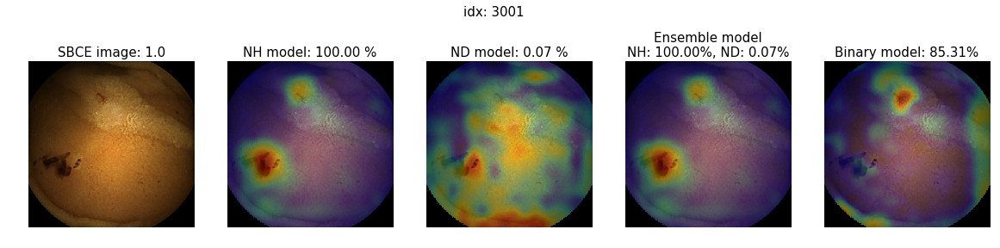

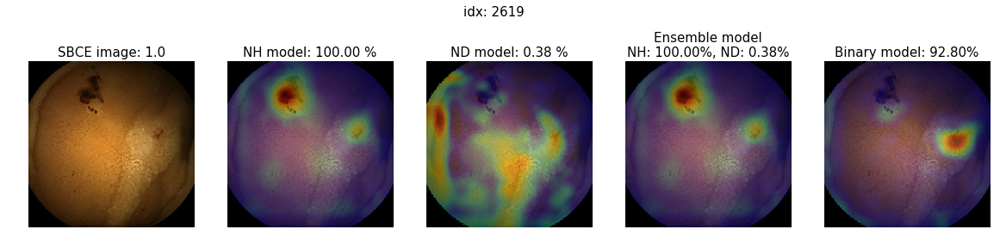

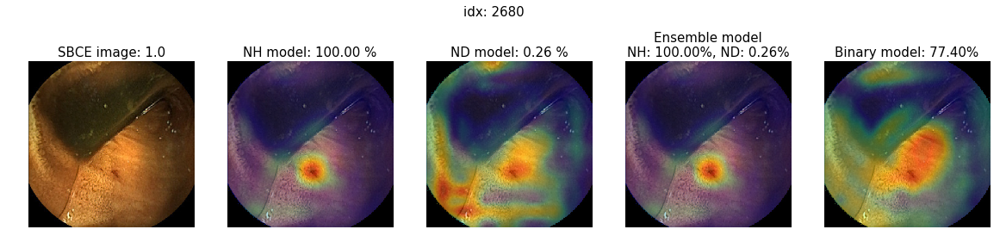

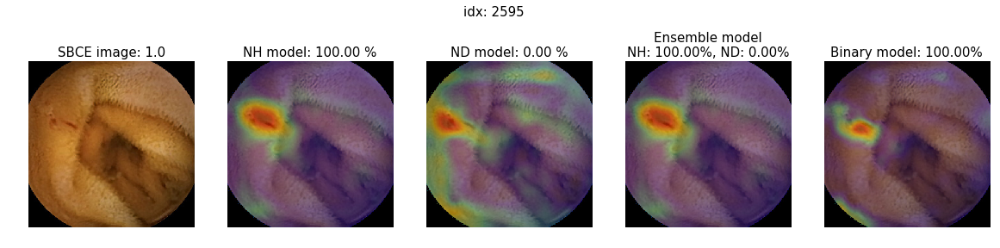

In [99]:
for i, n in zip(range(len(H_than_D)), H_than_D):
    plt.figure(figsize = (20, 5))
    plt.suptitle("idx: {}".format(n), y = 0.95, fontsize = 15)
    plt.subplot(151)
    plt.title("SBCE image: {}".format(test_y[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.axis('off')
    plt.subplot(152)
    plt.title("NH model: {:.2f} %".format(100*nh_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nh_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(153)
    plt.title("ND model: {:.2f} %".format(100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nd_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(154)
    plt.title("Ensemble model\nNH: {:.2f}%, ND: {:.2f}%".format(100*nh_output[n, 1], 100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(e_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(155)
    plt.title("Binary model: {:.2f}%".format(100*b_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(b_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.show()

In [ ]:
# 3763, 4748, 2619, 3232

## D than H

### chosen sample before

In [11]:
D_than_H = [3448, 4258, 3735, 3698, 4004, 3747, 3565, 4440, 2629]

In [12]:
nh_cam = NH_model.get_gradcam(test_x[D_than_H], featuremap_name = f_n)
nd_cam = ND_model.get_gradcam(test_x[D_than_H], featuremap_name = f_n)
e_cam = E_model.get_gradcam(test_x[D_than_H], featuremap_name = f_n)
b_cam = B_model.get_gradcam(test_x[D_than_H], featuremap_name = f_n)

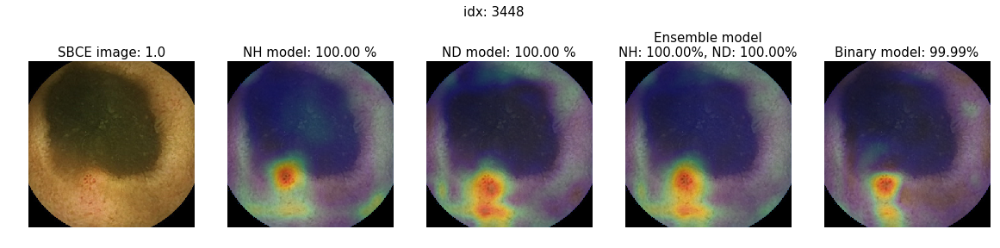

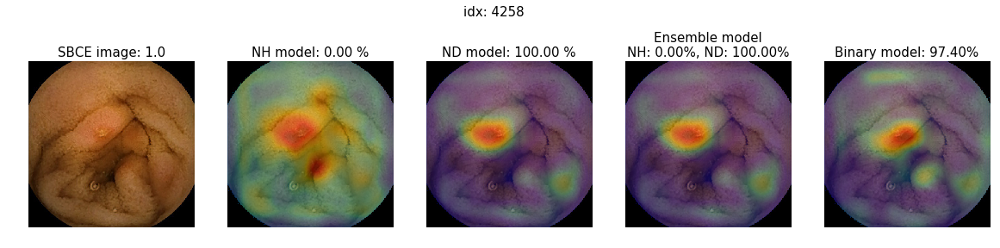

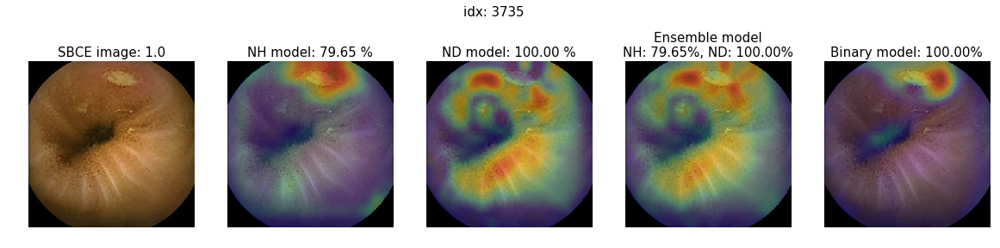

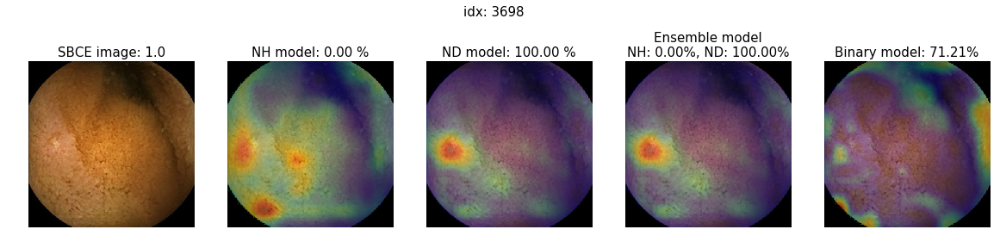

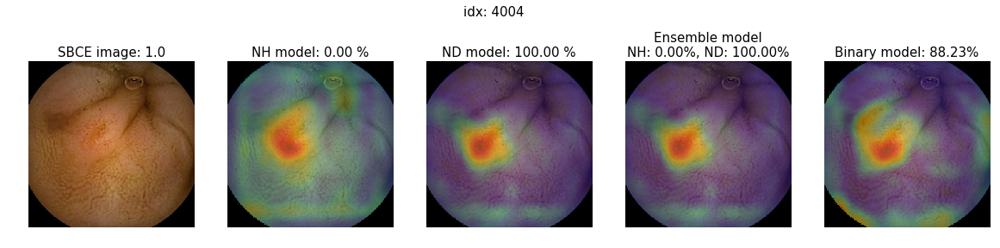

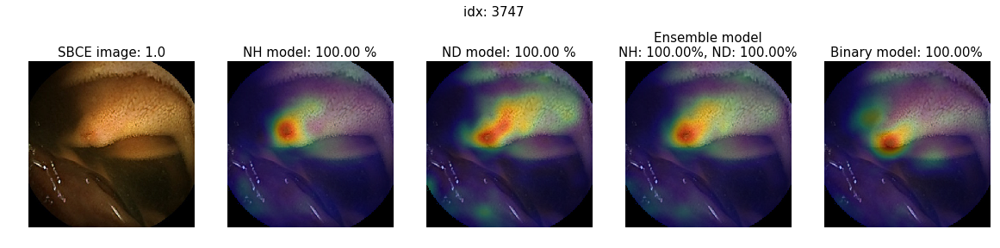

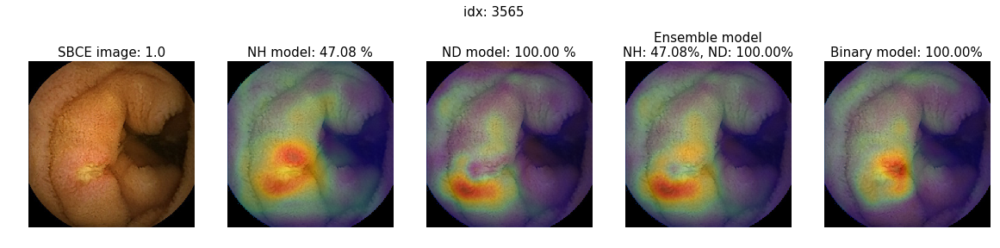

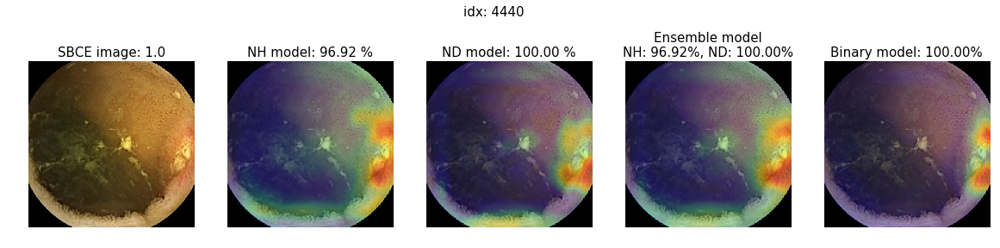

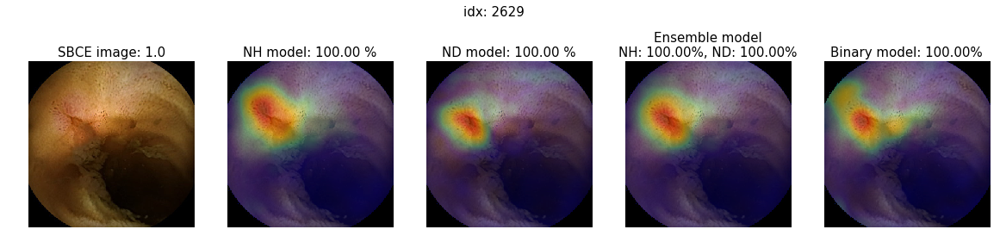

In [13]:
for i, n in zip(range(len(D_than_H)), D_than_H):
    plt.figure(figsize = (20, 5))
    plt.suptitle("idx: {}".format(n), y = 0.95, fontsize = 15)
    plt.subplot(151)
    plt.title("SBCE image: {}".format(test_y[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.axis('off')
    plt.subplot(152)
    plt.title("NH model: {:.2f} %".format(100*nh_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nh_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(153)
    plt.title("ND model: {:.2f} %".format(100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nd_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(154)
    plt.title("Ensemble model\nNH: {:.2f}%, ND: {:.2f}%".format(100*nh_output[n, 1], 100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(e_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(155)
    plt.title("Binary model: {:.2f}%".format(100*b_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(b_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.show()

In [14]:
n = [2940, 4396, 4513, 2595, 3448, 4258, 3698, 4004, 3747]
# n = [4440]
# n = [2629]
# n = [2453, 2629, 3165, 3448, 2745, 4440]

In [15]:
nh_cam = NH_model.get_gradcam(test_x[n], featuremap_name = f_n)
nd_cam = ND_model.get_gradcam(test_x[n], featuremap_name = f_n)
e_cam = E_model.get_gradcam(test_x[n], featuremap_name = f_n)
b_cam = B_model.get_gradcam(test_x[n], featuremap_name = f_n)

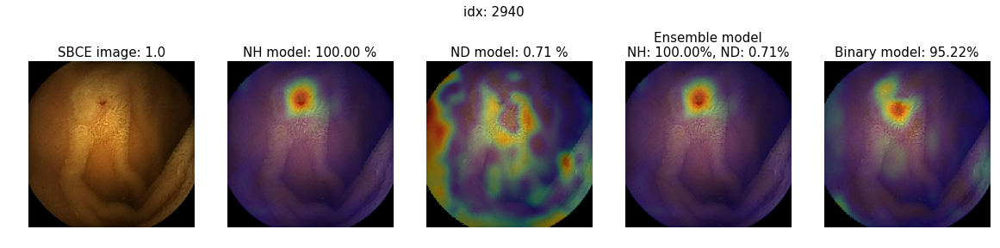

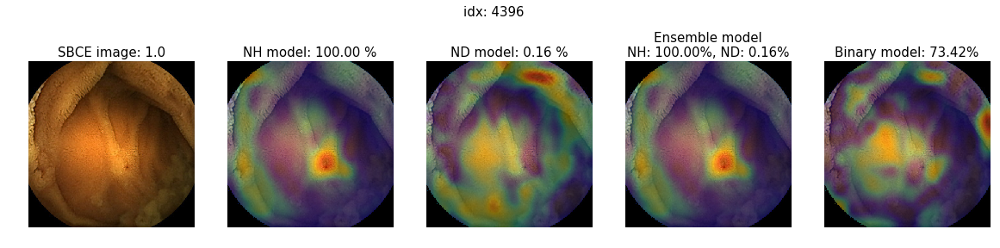

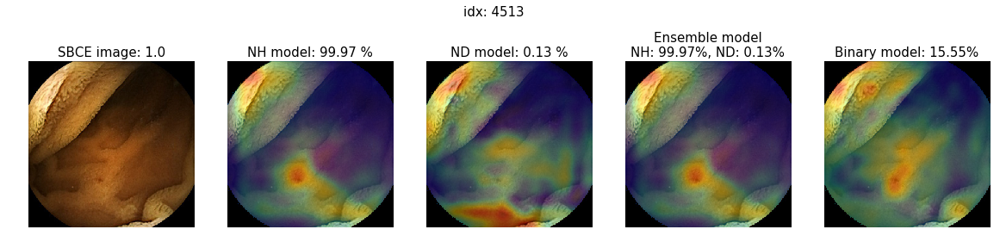

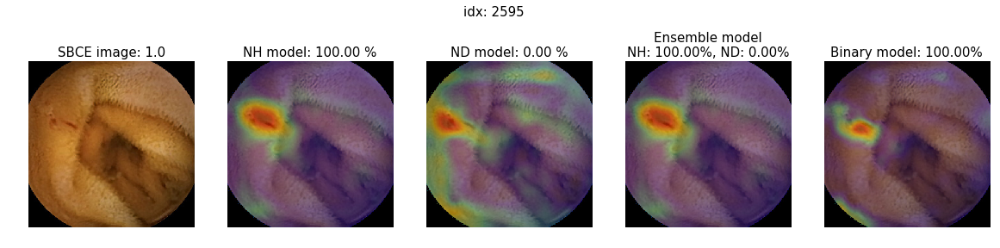

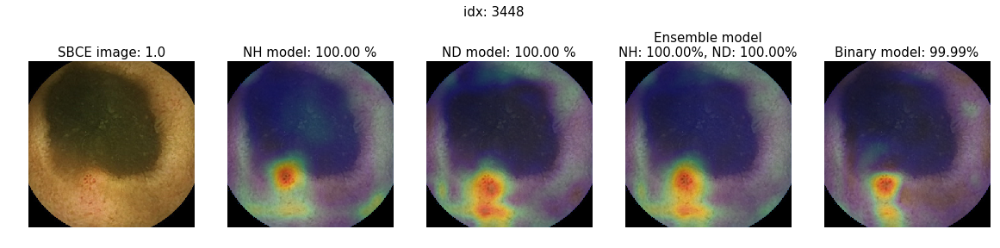

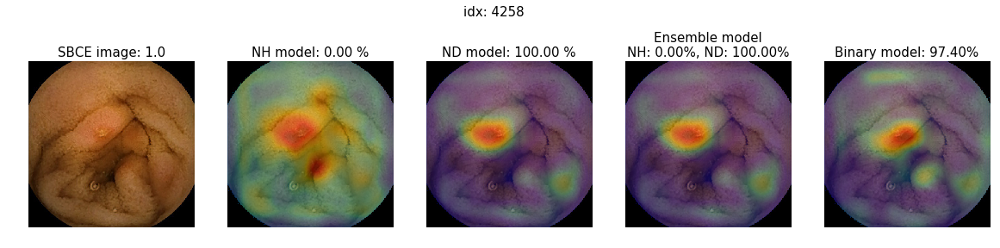

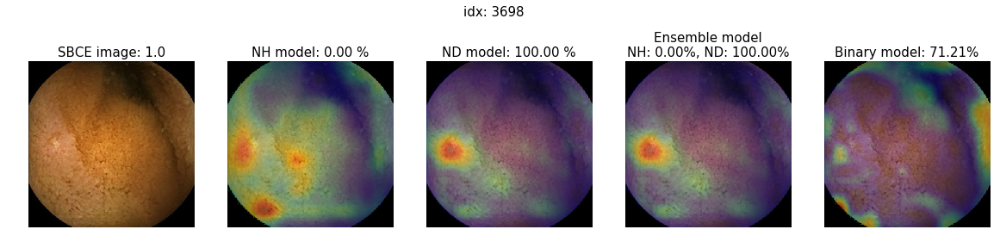

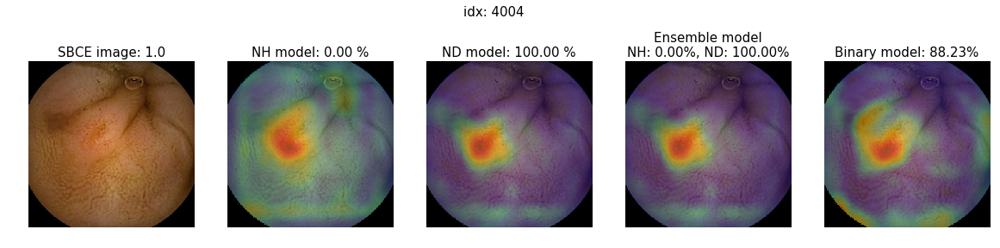

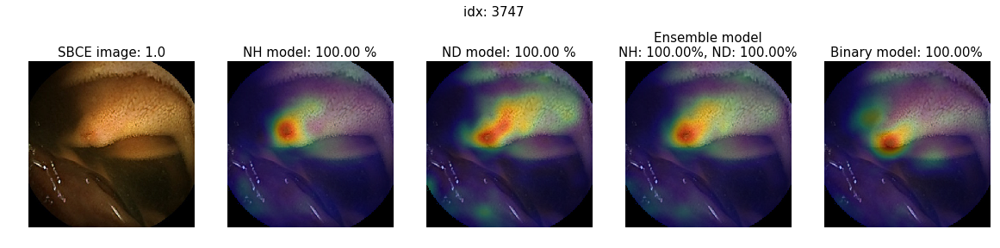

In [16]:
for i, idx in zip(range(len(n)), n):
    plt.figure(figsize = (20, 5))
    plt.suptitle("idx: {}".format(idx), y = 0.95, fontsize = 15)
    plt.subplot(151)
    plt.title("SBCE image: {}".format(test_y[idx, 1]), fontsize = 15)
    plt.imshow(test_x[idx])
    plt.axis('off')
    plt.subplot(152)
    plt.title("NH model: {:.2f} %".format(100*nh_output[idx, 1]), fontsize = 15)
    plt.imshow(test_x[idx])
    plt.imshow(nh_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(153)
    plt.title("ND model: {:.2f} %".format(100*nd_output[idx, 1]), fontsize = 15)
    plt.imshow(test_x[idx])
    plt.imshow(nd_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(154)
    plt.title("Ensemble model\nNH: {:.2f}%, ND: {:.2f}%".format(100*nh_output[idx, 1], 100*nd_output[idx, 1]), fontsize = 15)
    plt.imshow(test_x[idx])
    plt.imshow(e_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(155)
    plt.title("Binary model: {:.2f}%".format(100*b_output[idx, 1]), fontsize = 15)
    plt.imshow(test_x[idx])
    plt.imshow(b_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.show()

In [47]:
D_than_H = []

for i in range((len(test_x))):
    if nh_output[i, 1] < 0.5 and nd_output[i, 1] > 0.5:
        D_than_H.append(i) 
        
D_than_H = np.asarray(D_than_H)

In [48]:
batch_idxs = test_batch_idxs(D_than_H)

In [49]:
nh_cams, nd_cams, e_cams, b_cams  = [], [], [], []

for b_idx in batch_idxs:
    nh_cam = NH_model.get_gradcam(test_x[D_than_H[b_idx]], featuremap_name = f_n)
    nd_cam = ND_model.get_gradcam(test_x[D_than_H[b_idx]], featuremap_name = f_n)
    e_cam = E_model.get_gradcam(test_x[D_than_H[b_idx]], featuremap_name = f_n)
    b_cam = B_model.get_gradcam(test_x[D_than_H[b_idx]], featuremap_name = f_n)
    
    nh_cams.append(nh_cam), nd_cams.append(nd_cam), e_cams.append(e_cam), b_cams.append(b_cam)

In [50]:
nh_cams, nd_cams, e_cams, b_cams = batch_flatten(nh_cams), batch_flatten(nd_cams), batch_flatten(e_cams), batch_flatten(b_cams)

In [51]:
batch_idxs = test_batch_idxs(D_than_H, batch_size = 10)
len(batch_idxs)

47

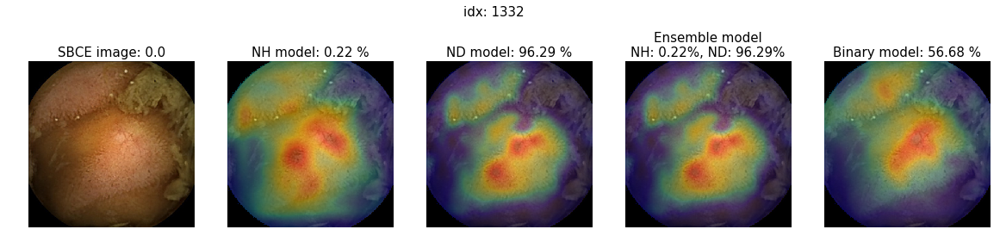

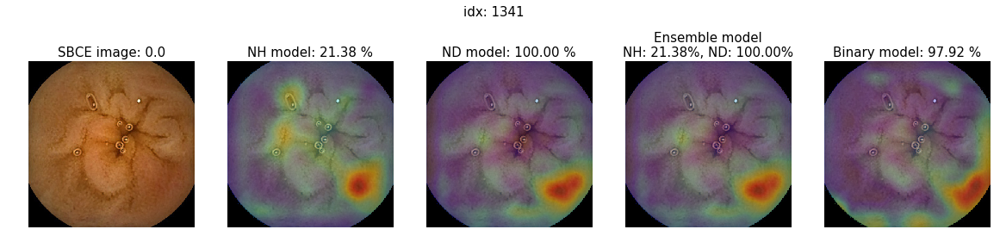

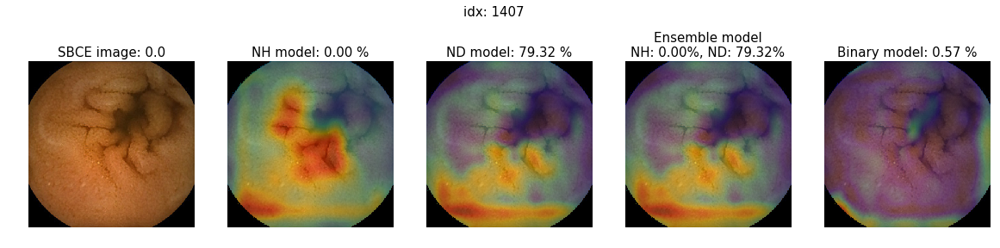

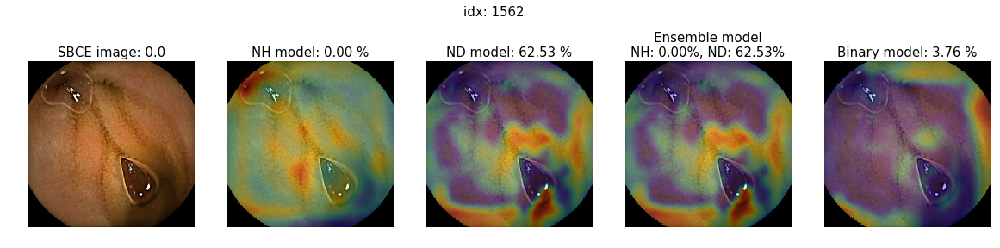

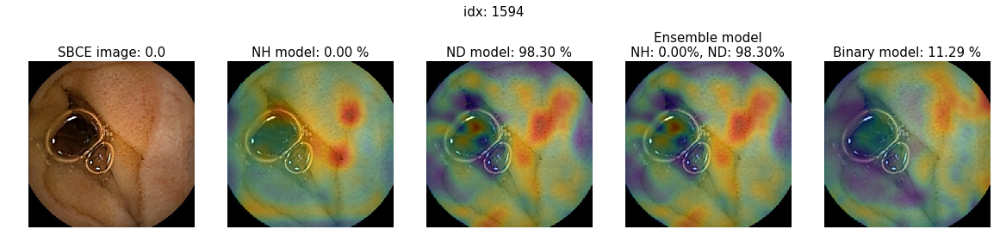

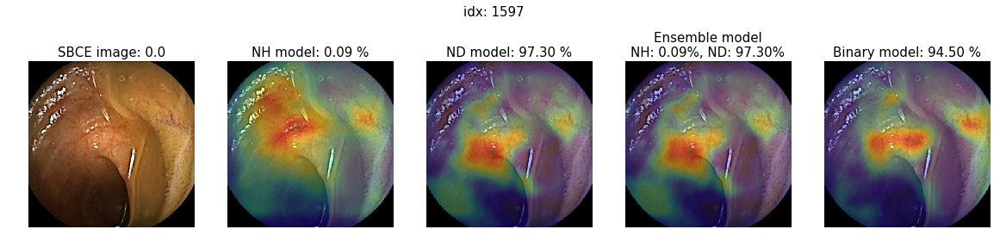

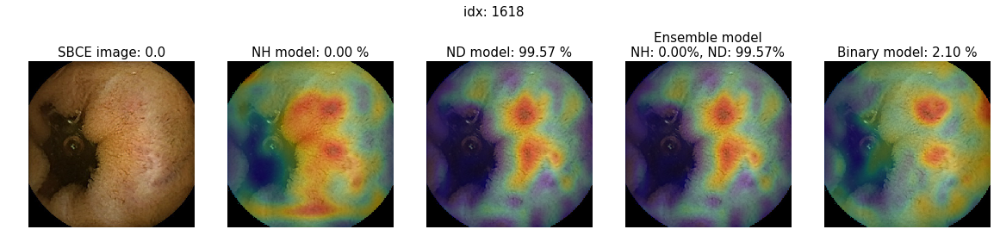

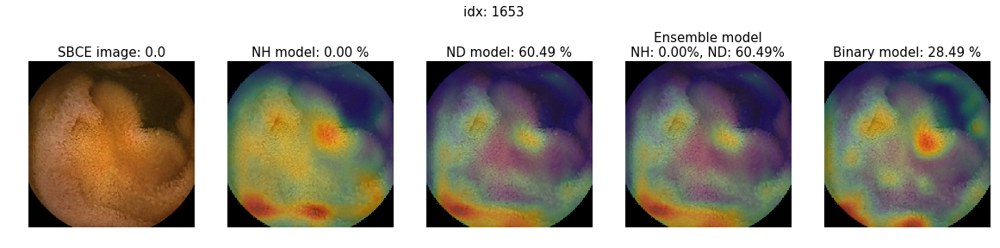

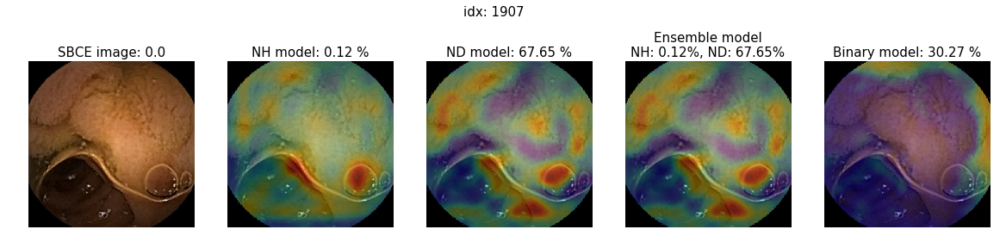

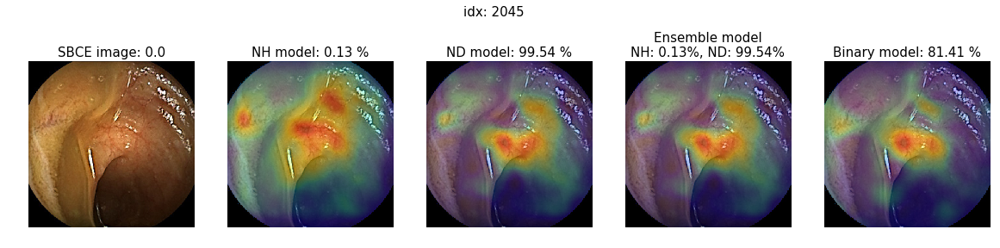

In [96]:
for i in batch_idxs[-45]:
    n = D_than_H[i]
    plt.figure(figsize = (20, 5))
    plt.suptitle("idx: {}".format(n), y = 0.95, fontsize = 15)
    plt.subplot(151)
    plt.title("SBCE image: {}".format(test_y[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.axis('off')
    plt.subplot(152)
    plt.title("NH model: {:.2f} %".format(100*nh_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nh_cams[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(153)
    plt.title("ND model: {:.2f} %".format(100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nd_cams[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(154)
    plt.title("Ensemble model\nNH: {:.2f}%, ND: {:.2f}%".format(100*nh_output[n, 1], 100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(e_cams[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(155)
    plt.title("Binary model: {:.2f} %".format(100*b_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(b_cams[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.show()

In [100]:
D_than_H =[4205, 4057, 4061, 3980, 3984, 4005, 3863, 3903, 3641, 3526, 3518, 3552, 3194, 3030, 2994, 2882, 2883, 2816,
           2817, 2705, 2635, 2676, 2607, 2492, 2406]

In [102]:
nh_cam = NH_model.get_gradcam(test_x[D_than_H], featuremap_name = f_n)
nd_cam = ND_model.get_gradcam(test_x[D_than_H], featuremap_name = f_n)
e_cam = E_model.get_gradcam(test_x[D_than_H], featuremap_name = f_n)
b_cam = B_model.get_gradcam(test_x[D_than_H], featuremap_name = f_n)

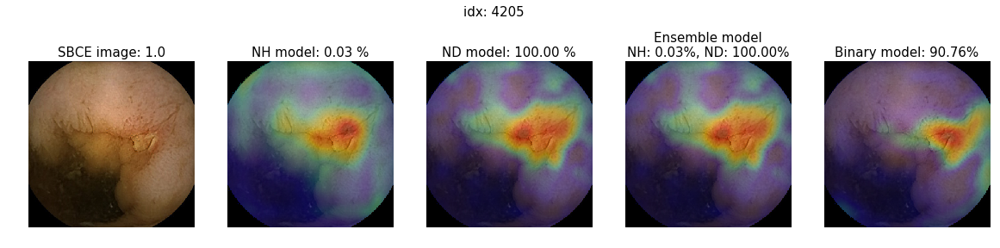

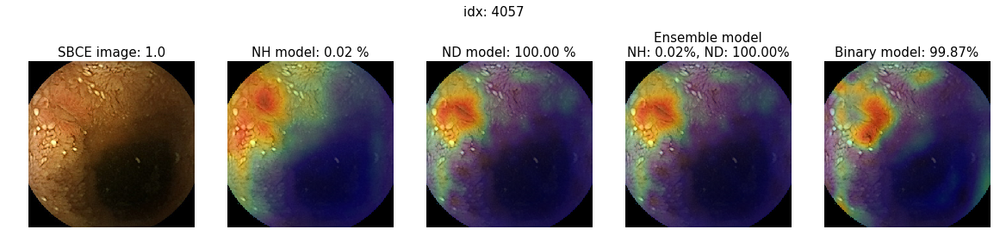

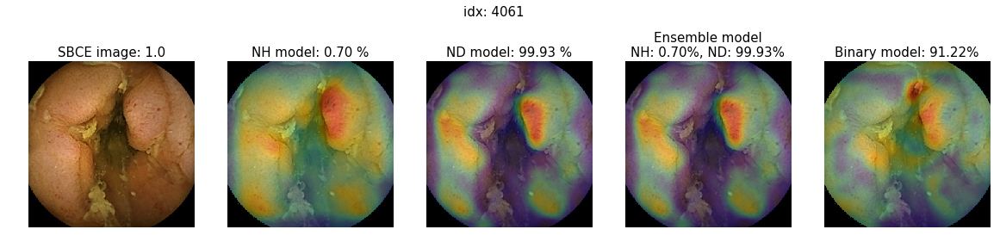

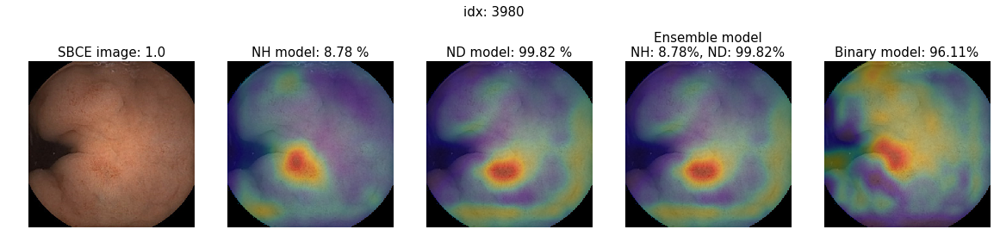

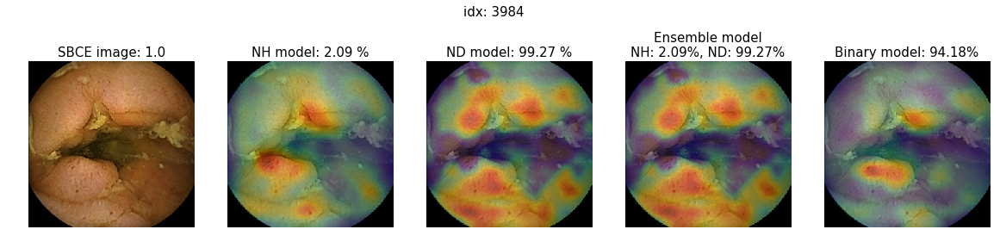

...

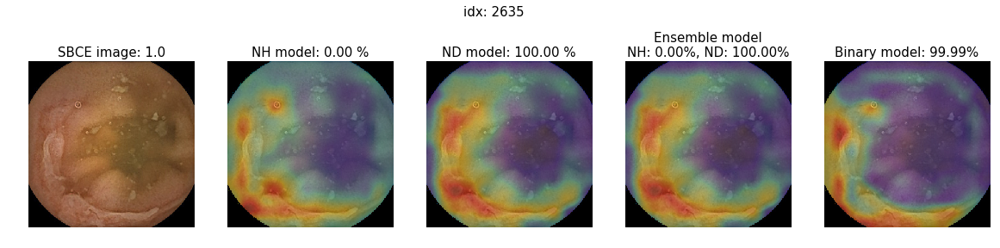

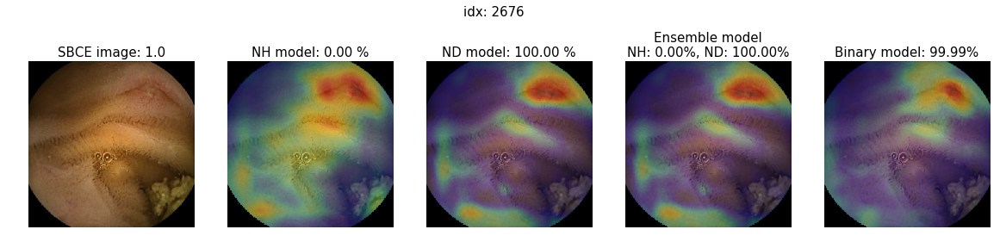

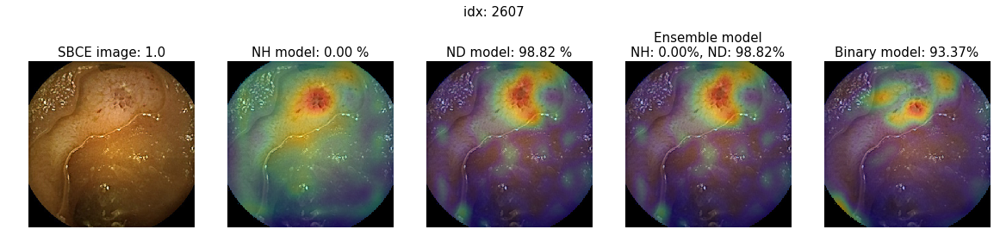

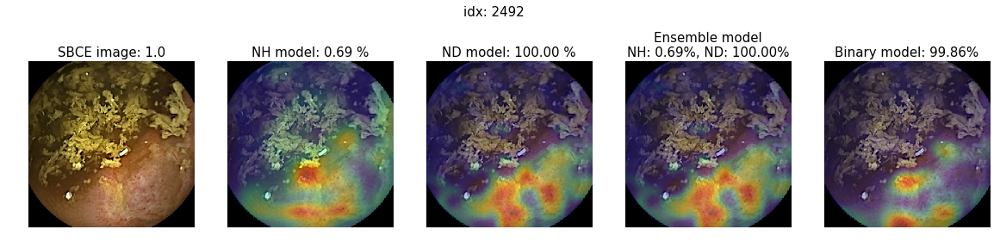

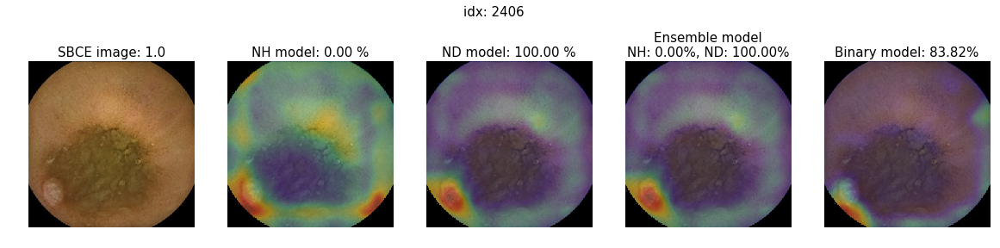

In [103]:
for i, n in zip(range(len(D_than_H)), D_than_H):
    plt.figure(figsize = (20, 5))
    plt.suptitle("idx: {}".format(n), y = 0.95, fontsize = 15)
    plt.subplot(151)
    plt.title("SBCE image: {}".format(test_y[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.axis('off')
    plt.subplot(152)
    plt.title("NH model: {:.2f} %".format(100*nh_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nh_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(153)
    plt.title("ND model: {:.2f} %".format(100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(nd_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(154)
    plt.title("Ensemble model\nNH: {:.2f}%, ND: {:.2f}%".format(100*nh_output[n, 1], 100*nd_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(e_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.subplot(155)
    plt.title("Binary model: {:.2f}%".format(100*b_output[n, 1]), fontsize = 15)
    plt.imshow(test_x[n])
    plt.imshow(b_cam[i], cmap = 'jet', alpha = 0.3)
    plt.axis('off')
    plt.show()

In [ ]:
# 2883, 2817

# Save figure

In [11]:
candidate = [2883, 2817, 3763, 4748, 2619, 3232]

In [12]:
nh_cam = NH_model.get_gradcam(test_x[candidate], featuremap_name = f_n)
nd_cam = ND_model.get_gradcam(test_x[candidate], featuremap_name = f_n)
e_cam = E_model.get_gradcam(test_x[candidate], featuremap_name = f_n)
b_cam = B_model.get_gradcam(test_x[candidate], featuremap_name = f_n)

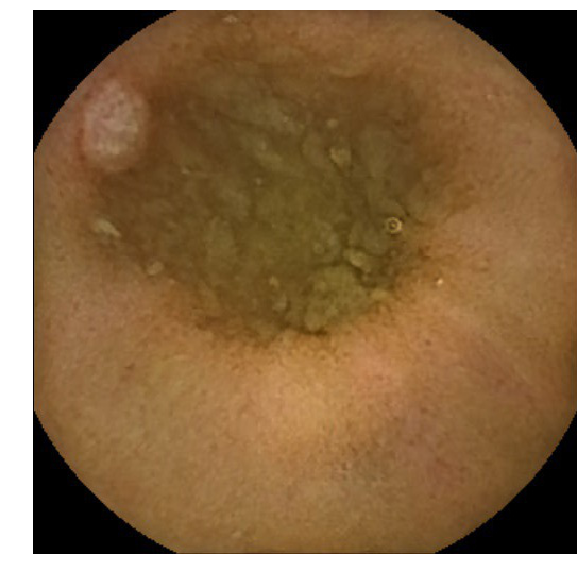

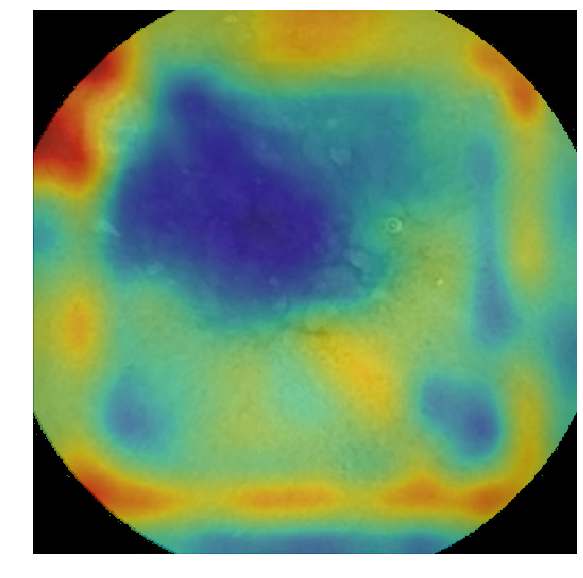

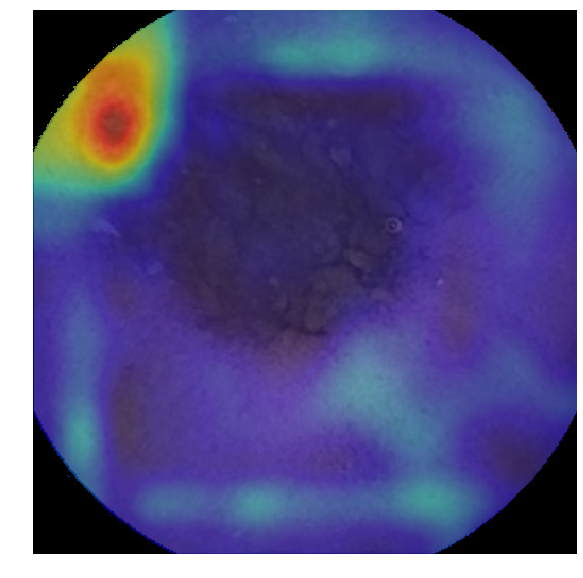

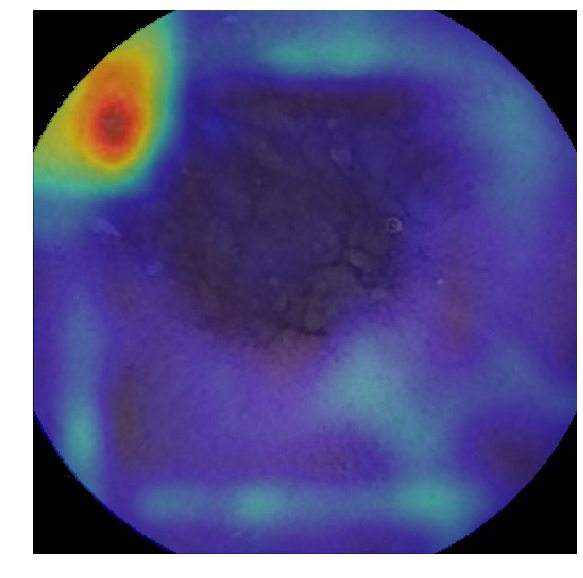

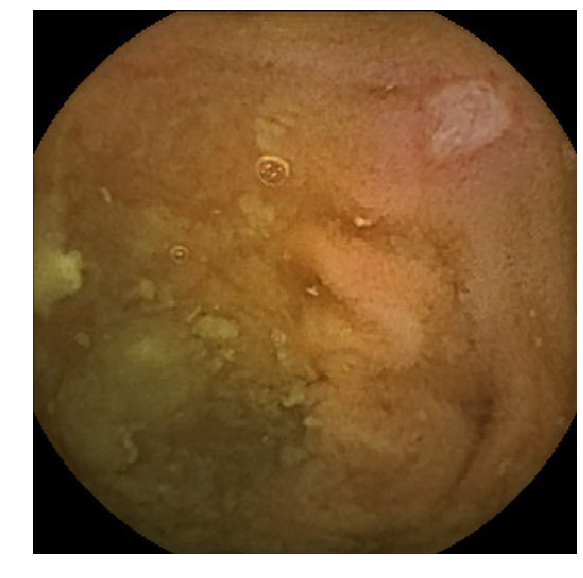

...

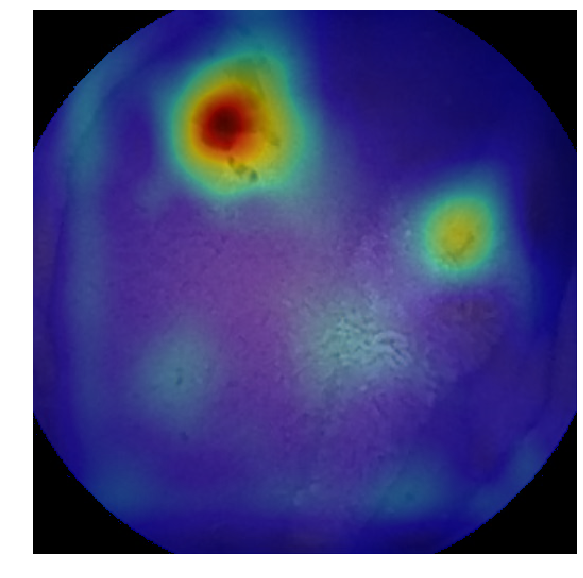

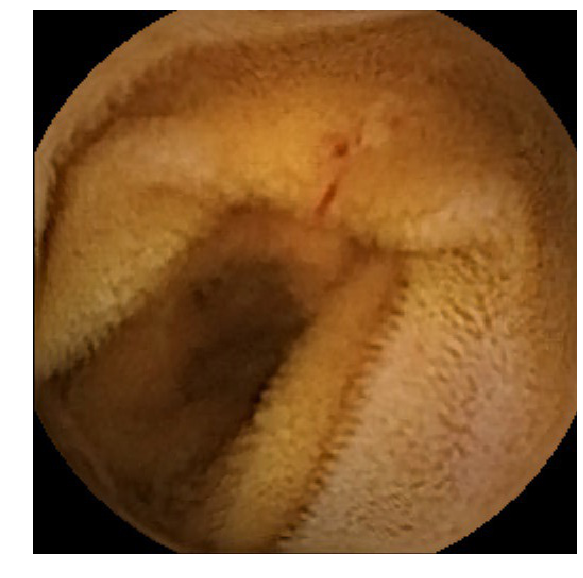

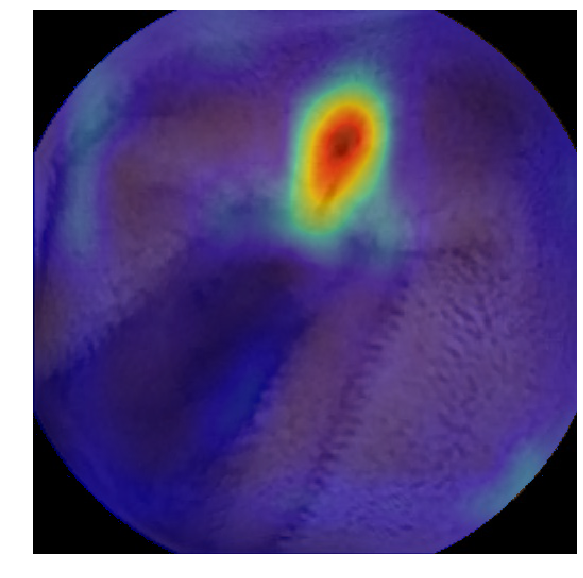

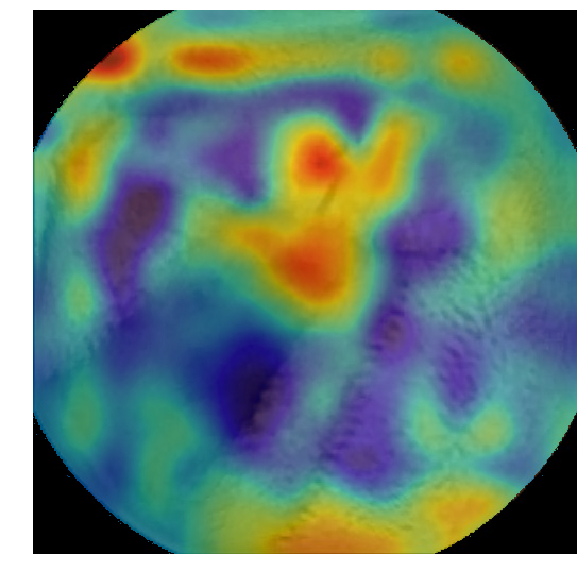

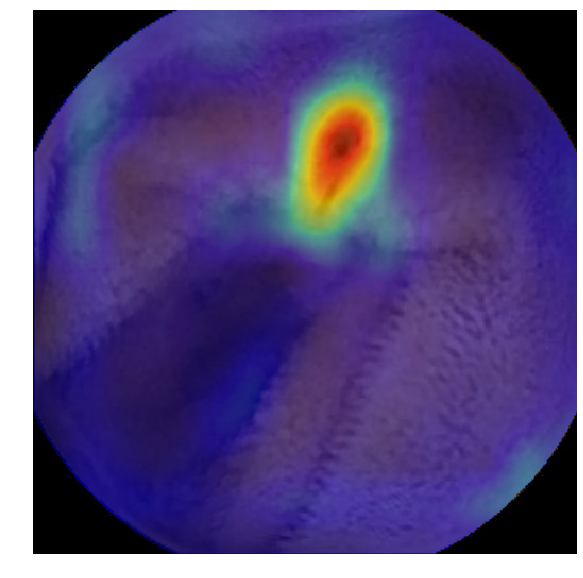

In [18]:
outputs = []

for i, j in zip(range(len(candidate)), candidate):
    fig = plt.figure(figsize = (10, 10))
    plt.imshow(test_x[j])
    plt.axis('off')
    fig.savefig('./gradcam/nh_nd_ensemble/GradCAM_wo_info_{}_o.png'.format(j), bbox_inches='tight', dpi=300)
    fig = plt.figure(figsize = (10, 10))
    plt.imshow(test_x[j])
    plt.imshow(nh_cam[i], alpha = 0.5)
    plt.axis('off')
    fig.savefig('./gradcam/nh_nd_ensemble/GradCAM_wo_info_{}_nh.png'.format(j), bbox_inches='tight', dpi=300)
    fig = plt.figure(figsize = (10, 10))
    plt.imshow(test_x[j])
    plt.imshow(nd_cam[i], alpha = 0.5)
    plt.axis('off')
    fig.savefig('./gradcam/nh_nd_ensemble/GradCAM_wo_info_{}_nd.png'.format(j), bbox_inches='tight', dpi=300)
    fig = plt.figure(figsize = (10, 10))
    plt.imshow(test_x[j])
    plt.imshow(e_cam[i], alpha = 0.5)
    plt.axis('off')
    fig.savefig('./gradcam/nh_nd_ensemble/GradCAM_wo_info_{}_e.png'.format(j), bbox_inches='tight', dpi=300)
    
    outputs.append([j, 100*nh_output[j, 1], 100*nd_output[j, 1]])

In [17]:
outputs = np.asarray(outputs)

outputs

array([[2.88300000e+03, 3.96558244e-04, 9.99999881e+01],
       [2.81700000e+03, 9.70416295e-04, 1.00000000e+02],
       [3.76300000e+03, 1.00000000e+02, 1.16010608e-04],
       [4.74800000e+03, 1.00000000e+02, 7.67556624e-01],
       [2.61900000e+03, 1.00000000e+02, 3.79625452e-01],
       [3.23200000e+03, 1.00000000e+02, 1.29039381e-03]])

In [19]:
import pandas
from pandas import DataFrame

In [ ]:
DataFrame